# 1-Ouverture et visualisation des images

In [18]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from skimage.io import imread, imshow
import os
import cv2 as cv
from PIL import Image

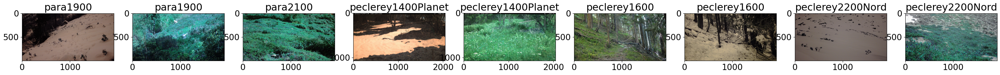

In [17]:
imgs = []
dir  = os.getcwd()
dir,__ = os.path.split(dir)
imgs_path = os.listdir(dir + '/SCAR/IMGS_9')
imgs_path.sort()

for i in imgs_path:
    imgs +=[cv.imread(f"{dir}/SCAR/IMGS_9/{i}")]
    
plt.rcParams.update({'font.size': 19})
fig, axs = plt.subplots(1, 9, figsize = (40, 10))
for i in range(len(imgs)):
    img=imgs[i]
    img=img[0:img.shape[0]-80,0:img.shape[1]]
    imgs[i]=img
    axs[i].imshow(img)
    axs[i].set_title(imgs_path[i][:-29])
plt.show()


# 2-Seuillage sur un niveau de gris

niveaux de seuils [75, 100, 125, 150, 175, 200, 225, 250]


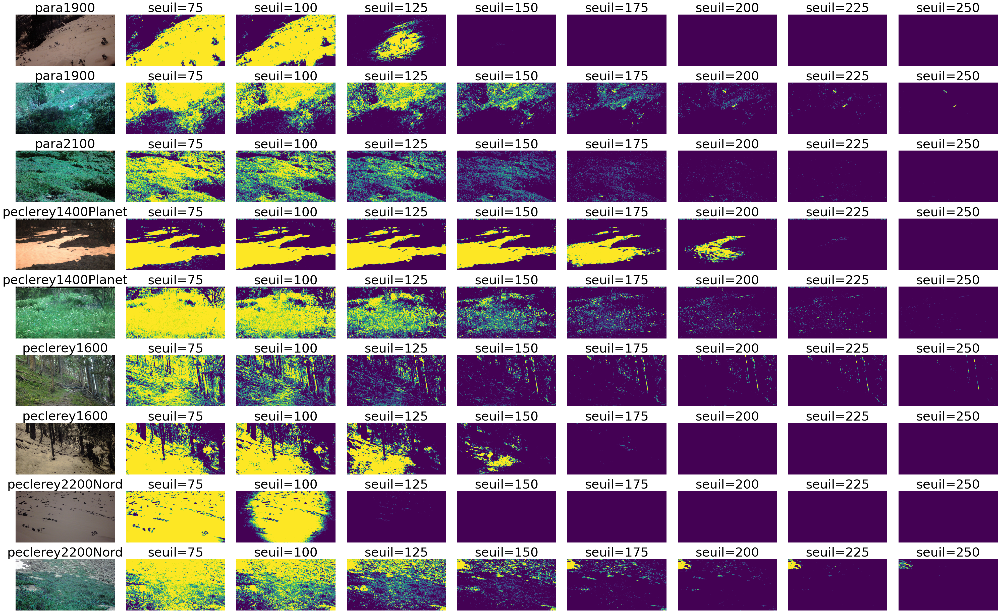

In [19]:
seuils = [75, 100, 125, 150, 175, 200, 225, 250]
print("niveaux de seuils", seuils)

plt.rcParams.update({'font.size': 30})
fig, axs = plt.subplots(9, 9, figsize = (40, 25))
for i in range (len(imgs)):
    img=imgs[i]
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    axs[i][0].imshow(img)
    axs[i][0].set_axis_off()
    axs[i][0].set_title(imgs_path[i][:-29])
    for j in range (len(seuils)):
        seuil=seuils[j]
        ret1,th1 = cv.threshold(gray, seuil, 255, cv.THRESH_BINARY)
        axs[i][j+1].imshow(th1)
        axs[i][j+1].set_axis_off()
        axs[i][j+1].set_title(f'seuil={seuil}')
plt.tight_layout()
plt.show()


# 3- Seuillage sur un niveau de vert

niveaux de vert minimum [15, 25, 50, 75, 100, 125, 150, 175]


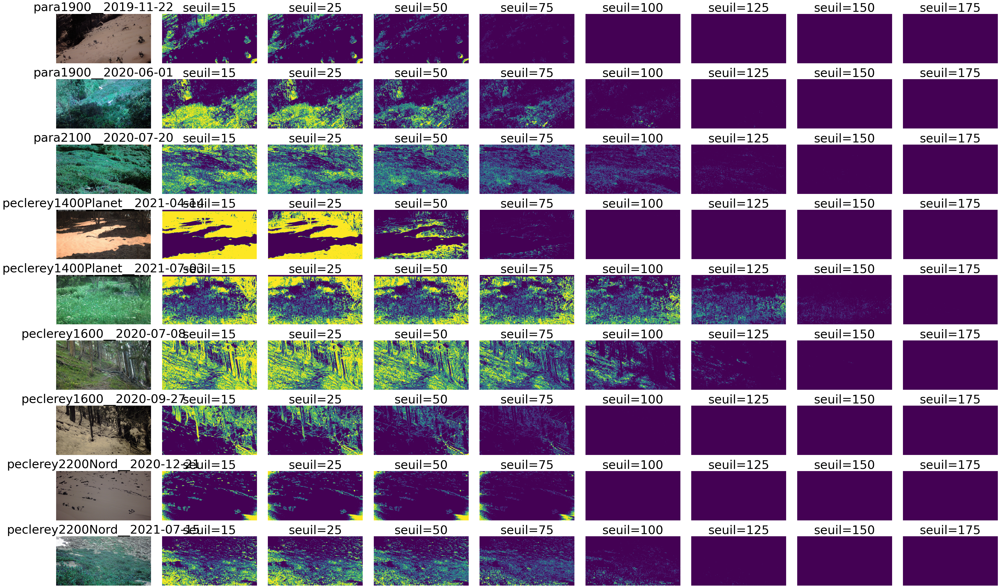

In [21]:
vert_min = [15,25,50,75,100,125,150,175]
print("niveaux de vert minimum", vert_min)

plt.rcParams.update({'font.size': 30})
fig, axs = plt.subplots(9, 9, figsize = (40, 25))
for i in range (len(imgs)):
    img=imgs[i]
    axs[i][0].imshow(img)
    axs[i][0].set_axis_off()
    axs[i][0].set_title(imgs_path[i][:-17])
    for j in range (len(vert_min)):
        v=vert_min[j]
        ret1=cv.inRange(img, (0, v, 0), (100,255,90))
        axs[i][j+1].imshow(ret1)
        axs[i][j+1].set_axis_off()
        axs[i][j+1].set_title(f'seuil={v}')
plt.tight_layout()
plt.show()


# 4-Test verdure/ neige

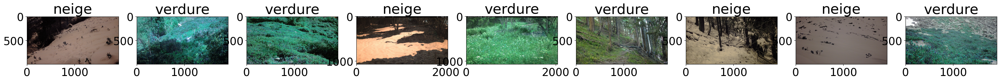

In [25]:
fig, axs = plt.subplots(1, 9, figsize = (40, 10))

plt.rcParams.update({'font.size': 27})
for i in range (len(imgs)):
    img=imgs[i]
    mask=cv.inRange(img, (0, 50, 0), (100,255,90))
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    if (np.sum(mask/255)*100/np.size(mask/255))>21:
        axs[i].set_title("verdure")
           
    else:
        ret1,th1 = cv.threshold(gray,0 , 255, cv.THRESH_BINARY)
        if (np.sum(th1/255)*100/np.size(th1/255))<45:
            axs[i].set_title("mi-saison")
               
        else:
            axs[i].set_title("neige")
    axs[i].imshow(imgs[i])          